In [12]:
import torch
import cv2
import numpy as np
from PIL import Image,ImageDraw

In [15]:
# img = cv2.imread(r"C:\Users\Raum\Desktop\รูปเจค\images\gg.jpg")
# img1 =  cv2.cvtColor(cv2.imread(r"C:\PaperPro\356_jpg.rf.6f7a781f17442a9aea0050da8aacd76e.jpg"),cv2.COLOR_BGR2RGB) มาเป็นarray ก่อน
# arr = Image.fromarray(img1) ละมาเปลี่ยนเป็นรูป ที่function fromarray นี้
img1 = Image.open(r"C:\Users\User\Pictures\JPic\CerColonyTest.jpg") #มาเป็นภาพเลอะ
img2 =  cv2.cvtColor(cv2.imread(r"C:\Users\User\Pictures\JPic\testsu.jpg"),cv2.COLOR_BGR2RGB)
brr = Image.fromarray(img2)

In [94]:
# img1

In [13]:
#model = torch.hub.load('.', 'custom', path=r"C:\ProJ\yolov5\bestW.pt", source='local').to('cuda')
model = torch.hub.load('.', 'custom', path=r"C:\ProJ\yolov5\runs\train\exp2\weights\best.pt", source='local').to('cpu')
model.eval()
print("")

YOLOv5  v7.0-298-g21f8f94d Python-3.9.0 torch-2.2.2+cu118 CUDA:0 (NVIDIA GeForce RTX 4060 Laptop GPU, 8188MiB)

Fusing layers... 
YOLOv5s summary: 157 layers, 7012822 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


In [14]:
model.conf = 0.25

In [16]:
image_all = [img1,brr]

In [18]:
X = model(image_all)
print(len(X),type(X),X)

2 <class 'models.common.Detections'> image 1/2: 4000x3453 20 colonys
image 2/2: 2566x2369 85 colonys
Speed: 29.8ms pre-process, 66.7ms inference, 1.0ms NMS per image at shape (2, 3, 640, 608)


In [8]:
X.pandas().xyxy[1]

,xmin,ymin,xmax,ymax,confidence,class,name
0,716.185852,1254.744019,973.952942,1512.285400,0.911885,0,colony
1,1166.140015,341.749969,1804.597534,770.663696,0.885406,0,colony
2,728.638733,1588.670288,920.707703,1712.305176,0.877348,0,colony
3,1168.494507,714.072510,1331.182251,847.733032,0.862243,0,colony
4,1473.329224,1064.896851,1613.063232,1197.535156,0.853700,0,colony
...,...,...,...,...,...,...,...
80,979.476196,1828.435669,1004.993164,1851.788452,0.272932,0,colony
81,820.837219,747.430054,848.554382,771.125732,0.272124,0,colony
82,560.444580,1944.459961,591.647644,1972.608765,0.262412,0,colony
83,601.437561,685.992432,631.014038,710.528931,0.260326,0,colony


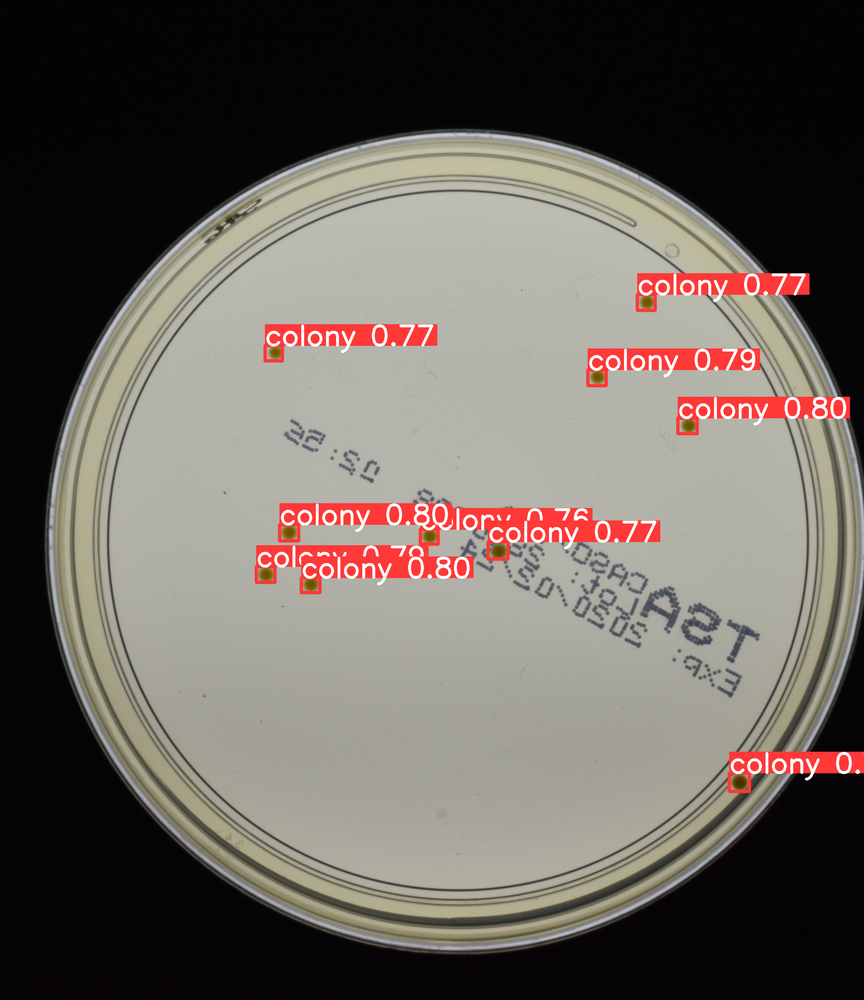

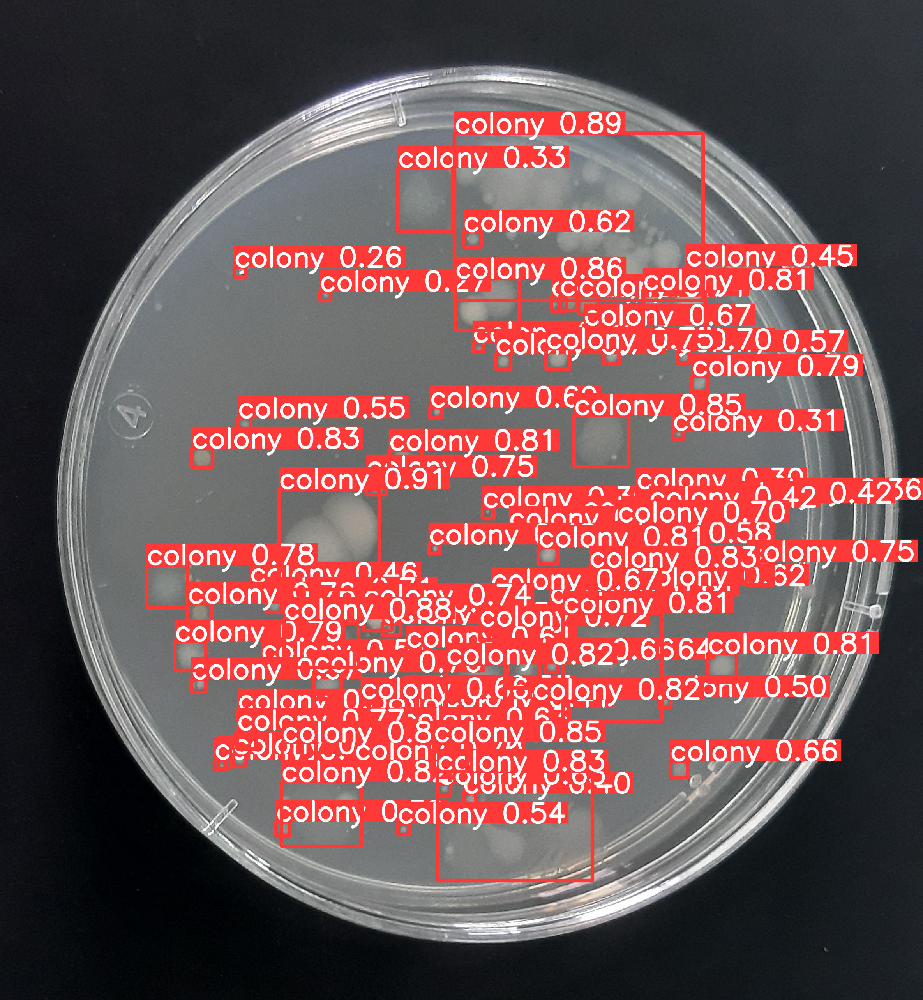

In [9]:
X.show()

In [19]:
predictions = X.pred[1]
print(len(predictions),type(predictions),predictions)
print(predictions[2][:4].tolist)

85 <class 'torch.Tensor'> tensor([[7.16186e+02, 1.25474e+03, 9.73953e+02, 1.51229e+03, 9.11885e-01, 0.00000e+00],
        [1.16614e+03, 3.41750e+02, 1.80460e+03, 7.70664e+02, 8.85406e-01, 0.00000e+00],
        [7.28639e+02, 1.58867e+03, 9.20708e+02, 1.71231e+03, 8.77348e-01, 0.00000e+00],
        [1.16849e+03, 7.14073e+02, 1.33118e+03, 8.47733e+02, 8.62243e-01, 0.00000e+00],
        [1.47333e+03, 1.06490e+03, 1.61306e+03, 1.19754e+03, 8.53700e-01, 0.00000e+00],
        [1.11309e+03, 1.90383e+03, 1.19815e+03, 1.97966e+03, 8.45998e-01, 0.00000e+00],
        [1.51291e+03, 1.45558e+03, 1.59630e+03, 1.53491e+03, 8.32339e-01, 0.00000e+00],
        [4.92218e+02, 1.15058e+03, 5.45686e+02, 1.19960e+03, 8.26920e-01, 0.00000e+00],
        [1.12247e+03, 1.97821e+03, 1.52099e+03, 2.25992e+03, 8.26326e-01, 0.00000e+00],
        [1.14564e+03, 1.70417e+03, 1.29697e+03, 1.82968e+03, 8.23068e-01, 0.00000e+00],
        [7.22011e+02, 2.00506e+03, 9.28742e+02, 2.17111e+03, 8.22597e-01, 0.00000e+00],
      

In [11]:
# pillow

brr = Image.fromarray(img2)

draw = ImageDraw.Draw(brr)
draw.rectangle([733,1587,906,1721],outline=(0,255,0),width=2) ;'''[x0, y0, x1, y1]'''
# draw.rectangle([(546,367),(573,421)],outline=(0,255,0),width=2) ;'''  [(x0, y0), (x1, y1)]'''
# brr

'[x0, y0, x1, y1]'

In [61]:
X = model(image_all)

In [63]:
numOfColony = []
ii = []
for i in range(len(image_all)):
    predictions = X.pred[i]
    numOfColony.append(len(predictions))
    draw = ImageDraw.Draw(image_all[i])
    for j in range(len(predictions)):
        xmin,	ymin,	xmax,	ymax =predictions[j][:4].tolist()
        draw.rectangle([int(xmin),int(ymin),int(xmax),int(ymax)],outline=(197, 200, 140),width=1) 
        

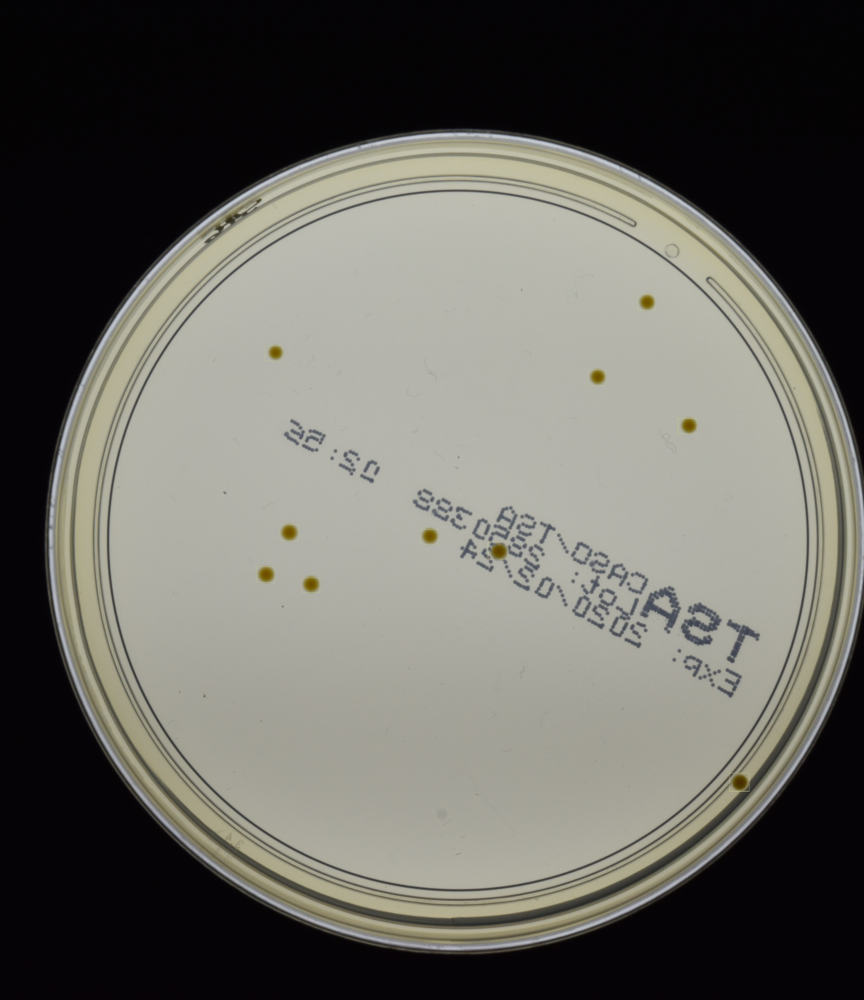

In [55]:
ii[0]

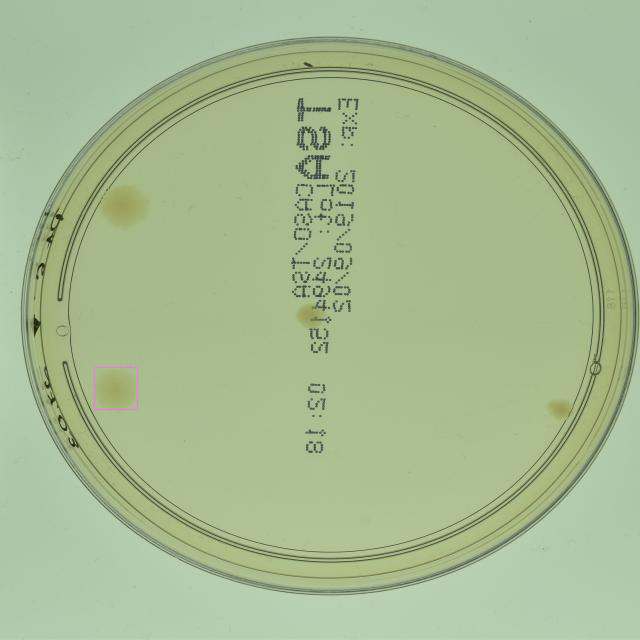

In [16]:
# opencv 
img =  cv2.cvtColor(cv2.imread(r"C:\PaperPro\356_jpg.rf.6f7a781f17442a9aea0050da8aacd76e.jpg"),cv2.COLOR_BGR2RGB)
img=cv2.rectangle(img,(94,367),(137,409),(255, 105, 250),1)
Image.fromarray(img)

In [17]:
img =  cv2.cvtColor(cv2.imread(r"C:\PaperPro\356_jpg.rf.6f7a781f17442a9aea0050da8aacd76e.jpg"),cv2.COLOR_BGR2RGB)
for i in range(len(predictions)):
    img=cv2.rectangle(img,(int(predictions[i][0]),int(predictions[i][1]),int(predictions[i][2]),int(predictions[i][3])),(255, 105, 250),1)

In [18]:
# opencv 
img =  cv2.cvtColor(cv2.imread(r"C:\PaperPro\356_jpg.rf.6f7a781f17442a9aea0050da8aacd76e.jpg"),cv2.COLOR_BGR2RGB)
center = ((94 + 137) // 2, (367 + 409) // 2)  # Average of rectangle's corners for center
radius = ((137 - 94) + (409 - 367)) // 4  # Average of rectangle's width and height for radius

# Draw the circle on the image
img = cv2.circle(img, center, radius, (255, 105, 250), 2)

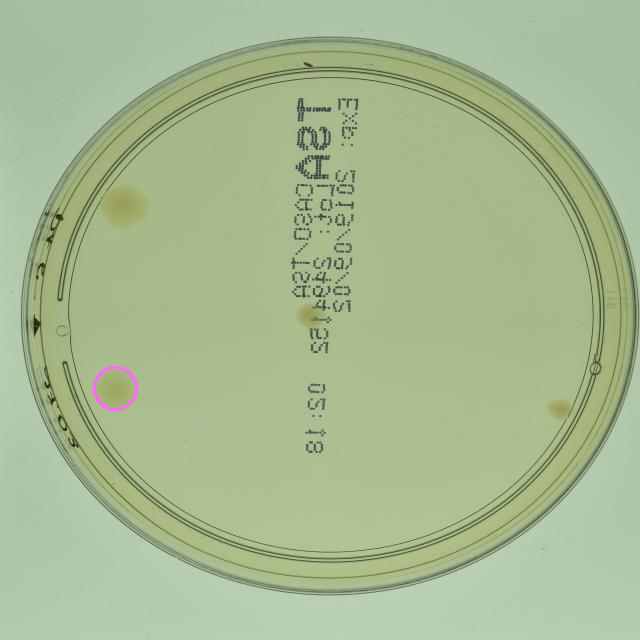

In [19]:
Image.fromarray(img)

In [97]:
def Colony_position(image_all):
    X = model(image_all)
    return X

def Colony_Counting(image_all,x):
    numOfColony = []
    poOfcolony = {}
    for i in range(len(image_all)):
        predictions = x.pred[i]
        numOfColony.append(len(predictions))

        position = []
        draw = ImageDraw.Draw(image_all[i])
        for j in range(len(predictions)):
            xmin,	ymin,	xmax,	ymax =predictions[j][:4].tolist()
            draw.rectangle([int(xmin),int(ymin),int(xmax),int(ymax)],outline=(0, 102, 255),width=2) 
            position.append([int(xmin),int(ymin),int(xmax),int(ymax)])

        poOfcolony[i]=position
    return numOfColony, poOfcolony

            

In [98]:
x = Colony_position(image_all)
z,e = Colony_Counting(image_all,x)
z

[10, 45]

In [99]:
e

{0: [[1204, 2311, 1276, 2369],
  [1118, 2098, 1194, 2163],
  [2351, 1479, 2425, 1542],
  [2718, 1673, 2788, 1732],
  [1026, 2266, 1098, 2329],
  [1954, 2166, 2031, 2236],
  [1064, 1386, 1120, 1439],
  [1680, 2117, 1750, 2175],
  [2550, 1179, 2619, 1238],
  [2916, 3099, 2992, 3164]],
 1: [[724, 1271, 967, 1501],
  [1147, 346, 1810, 778],
  [1120, 1967, 1536, 2280],
  [737, 1587, 907, 1711],
  [1474, 1070, 1606, 1196],
  [493, 1154, 545, 1200],
  [1174, 718, 1325, 842],
  [1512, 1455, 1594, 1533],
  [1146, 1708, 1288, 1827],
  [723, 1903, 806, 1982],
  [377, 1451, 483, 1551],
  [722, 2009, 932, 2162],
  [1002, 1156, 1079, 1221],
  [1370, 1800, 1456, 1880],
  [1818, 1674, 1884, 1739],
  [1119, 1905, 1190, 1970],
  [1644, 750, 1813, 837],
  [1383, 1407, 1427, 1448],
  [807, 1726, 871, 1791],
  [1922, 1441, 1980, 1494],
  [607, 1875, 653, 1920],
  [455, 1643, 518, 1714],
  [934, 1553, 999, 1614],
  [1408, 895, 1456, 940],
  [479, 1548, 541, 1619],
  [948, 1223, 990, 1262],
  [1299, 1695, 13

In [6]:
import PIL as pl


In [10]:
pl.__version__,cv2.__version__


('10.3.0', '4.9.0')